In [1]:
import numpy as np
import pandas as pd
import missingno as msno
# matplotlib and seaborn for plotting
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import LabelEncoder

import os

import warnings
warnings.filterwarnings('ignore')


In [2]:
# List files available
print(os.listdir("./data/"))

['sample_submission.csv', 'application_test.csv', 'POS_CASH_balance.csv', 'installments_payments.csv', 'bureau_balance.csv', 'previous_application.csv', 'bureau.csv', 'credit_card_balance.csv', 'application_train.csv', 'HomeCredit_columns_description.csv']


In [3]:
def importCsv(file_name:str) -> pd.DataFrame:
    df = pd.read_csv(f'data/{file_name}.csv')
    return df

In [4]:
train_data = importCsv('application_train')
test_data = importCsv('application_test')

In [5]:
print(train_data.shape)
print(test_data.shape)

(307511, 122)
(48744, 121)


In [6]:
def diffCols(df1, df2):
    colonnes_diff = []
    if set(df1.columns) != set(df2.columns):
        colonnes_diff.extend(list(set(df1.columns) - set(df2.columns)))
        colonnes_diff.extend(list(set(df2.columns) - set(df1.columns)))
    else:
        for colonne in df1.columns:
            if not df1[colonne].equals(df2[colonne]):
                colonnes_diff.append(colonne)
    return colonnes_diff

In [7]:
diffCols(train_data,test_data)

['TARGET']

In [8]:
#eda

In [9]:
#visualisation repartition classe target
px.pie(train_data, names='TARGET')

<Axes: >

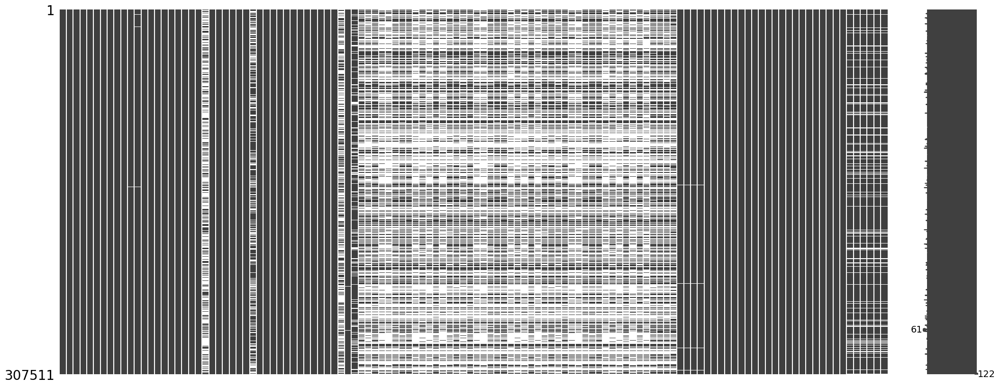

In [10]:
# visualisation valeurs manquantes
msno.matrix(train_data)

In [11]:
# vis sur les type des colonnes
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [12]:
# valeurs uniques par colonnes
train_data.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

### Encodage valeurs catégorielles 

In [13]:

def label_encoder(df):
    le_count = 0  # Initialisation du compteur de colonnes encodées

    # Création d'un objet LabelEncoder
    le = LabelEncoder()

    # Itération à travers les colonnes du DataFrame
    for col in df.columns:
        if df[col].dtype == 'object':  # Vérification si la colonne est de type 'object' (catégorielle)
            if len(df[col].unique()) <= 2:  # Si la colonne a 2 catégories ou moins
                # Entraînement sur les données d'entraînement
                le.fit(df[col])
                # Transformation des données d'entraînement
                df[col] = le.transform(df[col])
                # Incrément du compteur de colonnes encodées
                le_count += 1

    print('%d colonnes ont été label encodées.' % le_count)
    return df

In [14]:
label_encoder(train_data)

3 colonnes ont été label encodées.


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,0,M,0,1,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,0,F,0,0,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,1,M,1,1,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,0,F,0,1,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,0,M,0,1,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,M,0,0,0,157500.0,254700.0,27558.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,0,F,0,1,0,72000.0,269550.0,12001.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,0,F,0,1,0,153000.0,677664.0,29979.0,...,0,0,0,0,1.0,0.0,0.0,1.0,0.0,1.0
307509,456254,1,0,F,0,1,0,171000.0,370107.0,20205.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [15]:
# one-hot encoding of categorical variables
app_train = pd.get_dummies(train_data)
app_test = pd.get_dummies(test_data)

print("shape données d'entrainement: ", app_train.shape)
print("shape données d'entrainement: ", app_test.shape)

shape données d'entrainement:  (307511, 243)
shape données d'entrainement:  (48744, 242)


In [16]:
train_labels = app_train['TARGET']

# Align the training and testing data, keep only columns present in both dataframes
app_train, app_test = app_train.align(app_test, join = 'inner', axis = 1)

# Add the target back in
app_train['TARGET'] = train_labels

print('Training Features shape: ', app_train.shape)
print('Testing Features shape: ', app_test.shape)

Training Features shape:  (307511, 237)
Testing Features shape:  (48744, 236)


In [17]:
# retour eda
conversion_en_ages = (app_train['DAYS_BIRTH']/-365).describe()
conversion_en_ages

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

In [18]:
ages = (app_train['DAYS_BIRTH']/-365)
ages
px.box(ages)

# ==========
###### pas compris

In [19]:

app_train['DAYS_EMPLOYED'].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64